# imports stuff!

In [1]:
!pip install -q pytorch-lightning

     |████████████████████████████████| 706 kB 9.0 MB/s 
     |████████████████████████████████| 5.9 MB 46.8 MB/s 
     |████████████████████████████████| 419 kB 69.7 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.


In [2]:
import os
from glob import glob
from pathlib import Path
import datetime
import random
import math

import matplotlib.pyplot as plt
from PIL import Image

import numpy as np
import skimage
import skimage.metrics

import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset
import torchvision
from torchvision import transforms
from tqdm.auto import tqdm

import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint

In [3]:
# Set random seed for reproducibility
seed = 14383421    # with apologies to the funyarinpa
dataset_split_seed = 1797147     # with apologies to myself
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  14383421


## Retrieve dataset from google drive

In [4]:
from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive')

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


In [5]:
%%bash

# copying stuff to the colab vm
echo "Making dirs"
mkdir data
cd data
mkdir bsd-b
cd bsd-b
echo "Copying archive"
cp /content/drive/MyDrive/BSD_B_Centroid.tar.gz .
echo "Decompressing"
tar -xvf BSD_B_Centroid.tar.gz > /dev/null
echo "Done"

Making dirs
Copying archive
Decompressing
Done


# Dataset

Some data augmentations that will be used by the dataset

In [6]:
# essential not only for augmentation, but to enforce the correct size as well
# assumes both images are the same shape
def random_crop(img_pair, cropped_size):
    first, second = img_pair

    # -1 is only for irrational safety
    umax = first.shape[1] - cropped_size - 1
    vmax = first.shape[2] - cropped_size - 1

    u = random.randint(0, umax)
    v = random.randint(0, vmax)

    # random crop
    first = first[:, u:u+cropped_size, v:v+cropped_size]
    second = second[:, u:u+cropped_size, v:v+cropped_size]

    return first, second

And then proper data classes

In [7]:
path = "./data/bsd-b/"

class BSD_B_Dataset(Dataset):
    def __init__(self, path, target_size=None, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
        self.root_path = Path(path)
        self.list_fname = self.root_path / "BSB_B_Centroid_train.txt"    # I guess BSB (rather than BSD) is a typo on their part?
        self.target_size = target_size
        self.mean = mean
        self.std = std

        self.gt_fnames = []
        self.blur_fnames = []

        with open(self.list_fname) as f:
            for line in f:
                pair = line.split()
                self.gt_fnames.append(self.root_path / pair[0])
                self.blur_fnames.append(self.root_path / pair[1])

    def __len__(self):
        return len(self.gt_fnames)
    
    def getpair(self, idx):
        # open w/ PIL (no chance of BGR even by mistake! ^_^)
        gt = Image.open(self.gt_fnames[idx])
        blur = Image.open(self.blur_fnames[idx])

        # transform to torch tensors
        gt = transforms.functional.to_tensor(gt)
        blur = transforms.functional.to_tensor(blur)

        return gt, blur

    def __getitem__(self, idx):
        gt, blur = self.getpair(idx)

        gt = transforms.functional.normalize(gt, self.mean, self.std)
        blur = transforms.functional.normalize(blur, self.mean, self.std)

        if blur.shape != gt.shape:
            print("ZAN ZAN ZAN")
            print((self.gt_fnames[idx], self.blur_fnames[idx]))
            print((gt.shape, blur.shape))

        target_size = self.target_size
        if target_size:
            # crop for target size
            gt, blur = random_crop((gt, blur), target_size)

        return gt, blur

# test cell
guertena = BSD_B_Dataset(path)
guertena[0]
print("BSD_B_Dataset is go")

BSD_B_Dataset is go


Also make a DataModule to handle train/test split *(so we may evaluate the metrics on a different set at some hypothetical point in the future)*

In [8]:
class BSD_B_DataModule(pl.LightningDataModule):
    def __init__(
            self,
            data_path,
            batch_size,
            target_size=None,
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225],
            val_split=-1,       # *_split in [0,1]. Both express a part of the full dataset.
            test_split=-1,
            shuffle=True
    ):
        super().__init__()
        self.data_path = data_path
        self.batch_size = batch_size
        self.target_size = target_size
        self.mean = mean
        self.std = std
        self.val_split = val_split
        self.test_split = test_split
        self.shuffle = shuffle
    
    def prepare_data(self):
        pass   # no download!
    
    def setup(self, stage=None):    # stage is unused here, load the whole dataset
        bsd_full = BSD_B_Dataset(self.data_path, target_size=self.target_size, mean=self.mean, std=self.std)

        if self.test_split > 0:
            test_samples = int(math.floor( len(bsd_full) * self.test_split ))
            bsd_trainval, self.bsd_test = torch.utils.data.random_split(bsd_full, [len(bsd_full) - test_samples, test_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            bsd_trainval, self.bsd_test = bsd_full, None
        
        if self.val_split > 0:
            val_samples = int(math.floor( len(bsd_full) * self.val_split ))   # both splits are expressed on the full dataset
            self.bsd_train, self.bds_val = torch.utils.data.random_split(bsd_trainval, [len(bsd_trainval) - val_samples, val_samples], generator = torch.Generator().manual_seed(dataset_split_seed))
        else:
            self.bsd_train, self.bsd_val = bsd_trainval, None
    
    def train_dataloader(self):
        return DataLoader(self.bsd_train, batch_size=self.batch_size, shuffle=self.shuffle)
    
    def val_dataloader(self):
        if self.bsd_val != None:
            return DataLoader(self.bsd_val, batch_size=self.batch_size)
        else:
            return []
    
    def test_dataloader(self):
        if self.bsd_test != None:
            return DataLoader(self.bsd_test, batch_size=self.batch_size)
        else:
            return []

# test cell
grannyriddleton = BSD_B_DataModule(path, 32)
print("BSD_B_DataModule is go")

BSD_B_DataModule is go


# Architecture -- Networks

## NN Blocks

Need a few block definitions first, to streamline the actual model definition

### Traditional conv block

Will be used in different ways (alone and in the following resnet block), so it's highly customizable.

In [9]:
# traditional conv block (no residual)

class ConvBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=0, padding_mode="zeros", normaliz_factory=None, activation_factory=None):
        super().__init__()

        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, padding_mode=padding_mode)
        
        if normaliz_factory is None:
            self.norm = nn.InstanceNorm2d(out_channels)
        else:
            self.norm = normaliz_factory()    # use this to try other normalizations. Set factory to `lambda: None` to not use.
        self.use_norm = (self.norm is not None)
        
        if activation_factory is None:
            self.act = nn.ReLU()
        else:
            self.act = activation_factory()    # use this to try other activations. Set factory to `lambda: None` to not use. (useful for the resnet block)
        self.use_act = (self.act is not None)

    def forward(self, x):
        x = self.conv(x)
        if self.use_norm:
            x = self.norm(x)
        if self.use_act:
            x = self.act(x)
        return x

# test cell
aigis = ConvBlock(3, 27)
aigis.forward(torch.rand(3, 10, 10))
print("ConvBlock is go")

ConvBlock is go


### ResNet block

A residual block containing: conv -> norm -> relu -> (dropout) -> conv -> norm

In [10]:
class ResnetBlock(nn.Module):

    def __init__(self, channels, kernel_size=3, stride=1, padding=0, padding_mode="zeros", normaliz_factory=None, activation_factory=None, dropout_rate=0.5):
        super().__init__()

        self.conv1 = ConvBlock(
            channels, channels,     # cannot change channel no. to be comatible w/ residual
            kernel_size=kernel_size,
            stride=stride,
            padding=padding,     # choose to ensure same dim for residual!
            padding_mode=padding_mode,
            normaliz_factory=normaliz_factory,
            activation_factory=activation_factory
        )

        if dropout_rate is not None:
            self.use_dropout = True
            self.dropout = nn.Dropout(dropout_rate)
        else:
            self.use_dropout = False
            self.dropout = None

        self.conv2 = ConvBlock(
            channels, channels,     # cannot change channel no. to be comatible w/ residual
            kernel_size=kernel_size,
            stride=stride,
            padding=padding,     # choose to ensure same dim for residual!
            padding_mode=padding_mode,
            normaliz_factory=normaliz_factory,
            activation_factory = lambda: None    # no final activation, per specifications
        )

    def forward(self, x):
        y = self.conv1(x)
        if self.use_dropout:
            y = self.dropout(y)
        y = self.conv2(y)
        return x + y

# test cell
omegaxis = ResnetBlock(10, padding=1)
omegaxis.forward(torch.rand(10, 10, 10))
print("ResnetBlock is go")

ResnetBlock is go


### Transpose conv block

In [11]:
class ConvTranspBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=0, output_padding=0, padding_mode="zeros", normaliz_factory=None, activation_factory=None):
        super().__init__()

        self.tconv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride, padding=padding, output_padding=output_padding, padding_mode=padding_mode)

        if normaliz_factory is None:
            self.norm = nn.InstanceNorm2d(out_channels)
        else:
            self.norm = normaliz_factory()    # use this to try other normalizations. Set factory to `lambda: None` to not use.
        self.use_norm = (self.norm is not None)
        
        if activation_factory is None:
            self.act = nn.ReLU()
        else:
            self.act = activation_factory()    # use this to try other activations. Set factory to `lambda: None` to not use. (useful for the resnet block)
        self.use_act = (self.act is not None)

    def forward(self, x):
        x = self.tconv(x)
        if self.use_norm:
            x = self.norm(x)
        if self.use_act:
            x = self.act(x)
        return x

# test cell
porygon2 = ConvTranspBlock(27, 3)
porygon2.forward(torch.rand(27, 10, 10))
print("ConvTranspBlock is go")

ConvTranspBlock is go


## Generator

According to the DeblurGAN paper: https://arxiv.org/pdf/1711.07064.pdf
Check the model scheme in Figure 3 for reference

In [12]:
class Generator(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        LV1_CHANNELS = 64
        LV2_CHANNELS = 128
        LV3_CHANNELS = 256

        # first a 7x7 block
        self.start_7x7 = ConvBlock(in_channels, LV1_CHANNELS, kernel_size=7, padding=3, padding_mode="reflect")
        
        # then two 3x3 conv blocks
        self.conv_3x3_a = ConvBlock(LV1_CHANNELS, LV2_CHANNELS, kernel_size=3, stride=2, padding=1)
        self.conv_3x3_b = ConvBlock(LV2_CHANNELS, LV3_CHANNELS, kernel_size=3, stride=2, padding=1)

        # then NINE residual blocks
        self.resnets = [
            ResnetBlock(LV3_CHANNELS, kernel_size=3, padding=1, padding_mode="reflect", dropout_rate=0.5)
                for _ in range(9)
        ]
        self.resnets = nn.ModuleList(self.resnets)

        # then two tconv blocks
        self.tconv_3x3_a = ConvTranspBlock(LV3_CHANNELS, LV2_CHANNELS, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.tconv_3x3_b = ConvTranspBlock(LV2_CHANNELS, LV1_CHANNELS, kernel_size=3, stride=2, padding=1, output_padding=1)

        # final 7x7 layer produces actual image channels
        self.final_7x7 = ConvBlock(LV1_CHANNELS, out_channels, kernel_size=7, padding=3, padding_mode="reflect", normaliz_factory=(lambda: None), activation_factory=(lambda: nn.Tanh()))

    def forward(self, x):
        y = self.start_7x7(x)
        y = self.conv_3x3_a(y)
        y = self.conv_3x3_b(y)
        for resnet_block in self.resnets:
            y = resnet_block(y)
        y = self.tconv_3x3_a(y)
        y = self.tconv_3x3_b(y)
        y = self.final_7x7(y)

        # final twist: global skip connection (this model learns the residual, not the actual output)
        return torch.clamp(x + y, min=-1, max=1)

# test cell
kosmos = Generator(3, 3)
kosmos.forward(torch.rand(3, 32, 32))
print("Generator is go")

Generator is go


## Discriminator

A PatchGAN.

Note that, as per the paper, the discriminator is not conditioned on the original blurred image.

In [13]:
class Discriminator(nn.Module):
    def __init__(self, in_channels):
        super().__init__()

        # these are constant across most blocks
        KERNEL_SIZE = 4
        STRIDE = 2
        PADDING = 1
        ACT_FACTORY = lambda: nn.LeakyReLU(0.2)

        # initial block
        self.conv0 = ConvBlock(in_channels, 64, kernel_size=KERNEL_SIZE, stride=STRIDE, padding=PADDING, normaliz_factory=(lambda: None), activation_factory=ACT_FACTORY)

        # middle sequence
        self.conv1 = ConvBlock(64, 128, kernel_size=KERNEL_SIZE, stride=STRIDE, padding=PADDING, activation_factory=ACT_FACTORY)
        self.conv2 = ConvBlock(128, 256, kernel_size=KERNEL_SIZE, stride=STRIDE, padding=PADDING, activation_factory=ACT_FACTORY)

        # penultimate layer has stride 1 to nail the right final size (as per specification)
        self.conv3 = ConvBlock(256, 512, kernel_size=KERNEL_SIZE, stride=1, padding=PADDING, activation_factory=ACT_FACTORY)

        # final layer produces prediction maps (no norm or act, so note no ConvBlock)
        self.conv4 = nn.Conv2d(512, 1, kernel_size=KERNEL_SIZE, stride=1, padding=PADDING)

        # note: channel dimension is still there in the end, even if it's just 1 channel

    def forward(self, x):
        x = self.conv0(x)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        return x

# test cell
karn = Discriminator(3)
karn.forward(torch.rand(3, 32, 32))
print("Discriminator is go")

Discriminator is go


# Loss function

At least one, the WGAN-GP, doesn't have a standard implementation in pytorch

## WGAN-GP

See (3) and Algorithm 1 on the paper: https://arxiv.org/pdf/1704.00028.pdf

This is not a "usual" loss, there's no groundtruth involved but rather averages over the entire data distributions (approximated in practice by the batches) are computed. So this is batch-in, scalar-out, unlike a "usual" loss.

Algorithm 1 even uses different formulae for discriminator loss and generator loss, so we're going to implement them separately.

In [14]:
class WGAN_GP_discr(nn.Module):
    def __init__(self, the_lambda=10):
        super().__init__()
        self.LAMBDA = the_lambda

    def gradient_penalty(self, fake, real, discriminator_network):
        # randomly interpolate the images, each pair independently
        # so, generate <batch_dimension> random interp. coefficients
        # and expand to create a batch composed of that many constant 3D tensors.
        # Creating a tensor with all the singleton dimensions explicitly placed ensures that.
        batch_dim = fake.shape[0]
        alpha = torch.rand(batch_dim, 1, 1, 1, device=fake.device)     # same device as the rest please
        alpha = alpha.expand_as(fake)

        interpolated = alpha * fake + (1-alpha) * real

        # important step: we need to differentiate wrt this, not the discr's parameters,
        # so gotta tell autograd that this vector requires gradient
        interpolated = torch.autograd.Variable(interpolated, requires_grad=True)

        # calc gradient of D(interp) wrt interp
        interp_logits = discriminator_network(interpolated)

        interp_gradients = torch.autograd.grad(
            outputs = interp_logits,
            inputs = interpolated,
            grad_outputs = torch.ones_like(interp_logits, device=interp_logits.device),     # same device as the rest please
        )[0]    # returns a Tuple, get the actual tensor (we only asked one input, so Tuple has one element)

        # compute and return gradient penalty as per specifications
        # norm is of each single element, so we exclude the batch dimension.
        # mean averages over the batch.
        gradient_penalty = ((interp_gradients.norm(2, dim=[1,2,3]) - 1) ** 2).mean()
        return gradient_penalty

    def forward(self, fake, real, discriminator_network):
        # unlike a normal loss, gotta pass the actual images and not the discriminator's result
        # b/c the gradient penalty wants to interpolate over the images.
        fake_logits = discriminator_network(fake.detach())    # detaching for extra safety, but I still plan to pass the images already detached
        real_logits = discriminator_network(real.detach())    # detaching for extra safety, but I still plan to pass the images already detached

        fake_mean = fake_logits.mean()    # compute mean of the batch
        real_mean = real_logits.mean()    # compute mean of the batch

        grad_pent = self.gradient_penalty(fake.detach(), real.detach(), discriminator_network)
        return fake_mean - real_mean + self.LAMBDA * grad_pent



# test cell

# we have a batch of images
fake = torch.rand(5, 3, 256, 256)     # pretend these just came out of the generator
real = torch.rand_like(fake)          # and these from the dataset
# we have a discriminator
# whatever, let's just use Karn from the above cell
# let's try running this loss
criterion = WGAN_GP_discr()
criterion.forward(fake, real, karn)
print("WGAN_GP_discr is go")

WGAN_GP_discr is go


In [15]:
class WGAN_GP_gen(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, fake, discriminator_network):
        # there's no strict need to pass the discriminator here,
        # but since the discriminator loss requires it
        # I prefer to mirror the same usage.
        # Anyway, discriminate...
        fake_logits = discriminator_network(fake)
        # ...then return the negated average as per specifications.
        return -fake_logits.mean()

# test cell
fake = torch.rand(5, 3, 256, 256)
criterion = WGAN_GP_gen()
criterion.forward(fake, karn)
print("WGAN_GP_gen is go")

WGAN_GP_gen is go


## Perceptual Loss

Used as a content loss, it involves computing the MSE over the feature maps computed by a pretrained VGG19 truncated at an arbitrary convolutional layer.

That layer will be (3,3) as suggested by the paper.

In [16]:
def getTruncatedVGG19():
    conv_3_3_layer_index = 14   # this happens to be the index of conv layer (3,3) (verified via printing)
    vgg19 = torchvision.models.vgg19(pretrained=True).features    # features is the actual torch.nn.Module
    truncated = nn.Sequential()
    for i, layer in enumerate(list(vgg19)):
        truncated.add_module(str(i), layer)
        if i == conv_3_3_layer_index:
            break
    return truncated

class PerceptualLoss(nn.Module):
    def __init__(self, criterion="DEFAULT"):
        super().__init__()
        if criterion == "DEFAULT":
            criterion = nn.MSELoss()
        self.criterion = criterion
        self.phi = getTruncatedVGG19()

    def forward(self, fake, real):
        # pass the batches through VGG19 (truncated)
        fake_feats = self.phi(fake)
        real_feats = self.phi(real)
        # then just do the MSE between them.
        # detach the real ones as we don't care about their gradients, obv
        loss = self.criterion(fake_feats, real_feats.detach())
        return loss

# test cell
fake = torch.rand(5, 3, 256, 256)
real = torch.rand_like(fake)
criterion = PerceptualLoss()
criterion.forward(fake, real)
print("PerceptualLoss is go")

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

PerceptualLoss is go


# Architecture -- Full Model

*(some utils first)*

In [17]:
# https://stackoverflow.com/questions/49433936/how-to-initialize-weights-in-pytorch

# randomize initial weights by a normal distribution
def _weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# shows blurred input, real original image, and generator output side by side for qualitative comparison.
# also takes care of converting from torch tensor (potentially) in the GPU to visualizable images.
def show_images_sidebyside(cond, fake, real, denormalization, figsize=(10,5)):
    cond = denormalization(cond)
    fake = denormalization(fake)
    real = denormalization(real)

    cond = cond.detach().cpu().permute(1, 2, 0)
    fake = fake.detach().cpu().permute(1, 2, 0)
    real = real.detach().cpu().permute(1, 2, 0)
    
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    ax[0].imshow(cond)
    ax[2].imshow(fake)
    ax[1].imshow(real)
    plt.show()

# invert normalization to visualize.
# explained here: https://discuss.pytorch.org/t/simple-way-to-inverse-transform-normalization/4821/4
def denormalize(img, mean, std):
    mean_r, mean_g, mean_b = mean
    std_r, std_g, std_b = std
    return transforms.functional.normalize(
        img,
        [-mean_r/std_r, -mean_g/std_g, -mean_b/std_b],
        [      1/std_r,       1/std_g,       1/std_b]
    )

def denormalize_factory(the_mean, the_std):
    return lambda img: denormalize(img, the_mean, the_std)

## Full GAN for real

In [18]:
class DeblurGAN(pl.LightningModule):
    def __init__(self, in_channels, out_channels, learning_rate=0.0002, lambda_content=100, display_step=25, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):

        super().__init__()
        self.save_hyperparameters()     # This Lightning black magic saves all the parameters of __init__ without us telling it anything. Not sure how it's possible, but it is.
        
        self.display_step = display_step
        self.gen = Generator(in_channels, out_channels)
        self.discr = Discriminator(out_channels)

        # init weights
        self.gen = self.gen.apply(_weights_init)
        self.discr = self.discr.apply(_weights_init)

        # loss functions
        self.advers_criterion_discr = WGAN_GP_discr()
        self.advers_criterion_gen = WGAN_GP_gen()
        self.content_criterion = PerceptualLoss()

    def _gen_step(self, real_images, conditioning_images):
        # Generate!
        fake_images = self.gen(conditioning_images)

        # Calc adversarial loss...
        advers_loss = self.advers_criterion_gen(fake_images, self.discr)

        # ...then content loss...
        content_loss = self.content_criterion(fake_images, real_images)

        # ...finally combine with scale factor
        return advers_loss + self.hparams.lambda_content * content_loss

    def _discr_step(self, real_images, conditioning_images):
        # Generate! (and don't do gradient)
        fake_images = self.gen(conditioning_images).detach()

        # Calc loss
        loss = self.advers_criterion_discr(fake_images, real_images, self.discr)
        
        return loss

    def configure_optimizers(self):
        lr = self.hparams.learning_rate
        gen_opt = torch.optim.Adam(self.gen.parameters(), lr=lr)
        discr_opt = torch.optim.Adam(self.discr.parameters(), lr=lr)
        return discr_opt, gen_opt

    def training_step(self, batch, batch_idx, optimizer_idx):
        real, conditioning = batch

        # Step and log loss
        loss = None
        if optimizer_idx == 0:
            loss = self._discr_step(real, conditioning)
            self.log('Discrimonator Loss', loss)
        elif optimizer_idx == 1:
            loss = self._gen_step(real, conditioning)
            self.log('Generator Loss', loss)
        
        # show example images from time to time to qualitatively show some progress
        if self.current_epoch % self.display_step == 0 and batch_idx == 0 and optimizer_idx == 1:
            fake = self.gen(conditioning).detach()
            the_denormalize = denormalize_factory(self.hparams.mean, self.hparams.std)
            real0_for_psnr = the_denormalize(real[0]).cpu().numpy()
            fake0_for_psnr = the_denormalize(fake[0]).cpu().numpy()
            true_min, true_max = np.min(real0_for_psnr), np.max(real0_for_psnr)
            print("----", true_min, ",,", true_max)
            psnr = skimage.metrics.peak_signal_noise_ratio(
                real0_for_psnr,
                fake0_for_psnr
            )
            print("=====")
            print("This is epoch", self.current_epoch)
            print("And the PSNR is", psnr)
            print("And the images are...")
            show_images_sidebyside(conditioning[0], fake[0], real[0], lambda x:x)    # per ora voglio vedere sia normalizzate che denormalizzate
            show_images_sidebyside(conditioning[0], fake[0], real[0], the_denormalize)
        return loss

# Training!

## Parameters

In [22]:
# mean and standard deviation for normalization, calcuated manually over the dataset una-tantum.
# the code is in another notebook.
mean = [0.4355969288502789, 0.43763443105665034, 0.3649651865988699]
std = [0.23582929701856753, 0.2207150368759555, 0.23132070247996644]

lambda_content = 100

n_epochs = 2000

display_step = 1
batch_size = 4
lr = 0.0002
target_size = 128

isodate = datetime.date.today().isoformat().replace("-", "")   # example: "20220624"
checkpoint_callback = ModelCheckpoint(
    save_top_k = -1, # i.e. save all, as per doc
    every_n_epochs = 4,
    save_on_train_epoch_end = True,
    dirpath = "/content/drive/MyDrive/VP/Checkpoints",
    filename = "ckpt-pix2pix-"+isodate+"-{epoch:02d}",
)

## Tensorboard

In [20]:
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

## Reach out to de-blur

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:448: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  f"Setting `Trainer(gpus={gpus!r})` is depre

Training: 0it [00:00, ?it/s]

---- 0.0039215502 ,, 1.0
=====
This is epoch 0
And the PSNR is 18.228638454790907
And the images are...


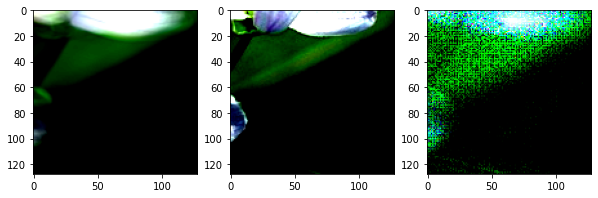

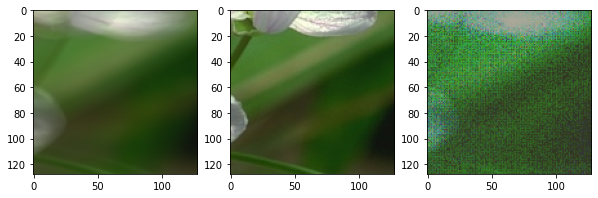

---- 0.10196077 ,, 0.74901956
=====
This is epoch 1
And the PSNR is 26.003277479197507
And the images are...


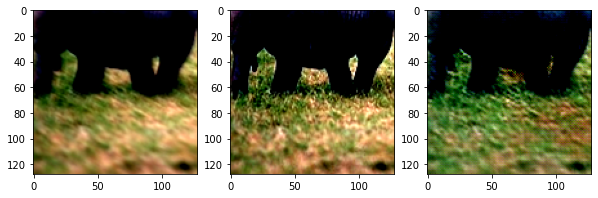

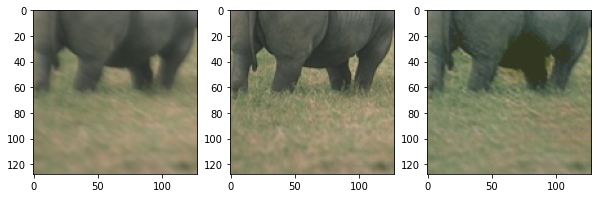

---- 0.0039215502 ,, 1.0
=====
This is epoch 2
And the PSNR is 18.67125718376546
And the images are...


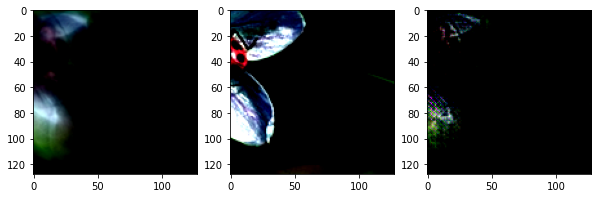

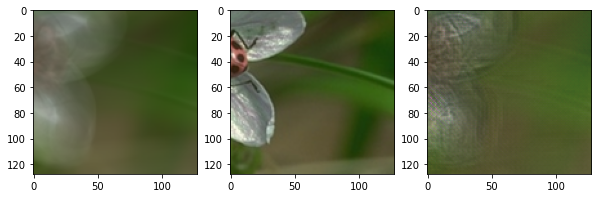

---- 0.0 ,, 1.0
=====
This is epoch 3
And the PSNR is 17.301335165169615
And the images are...


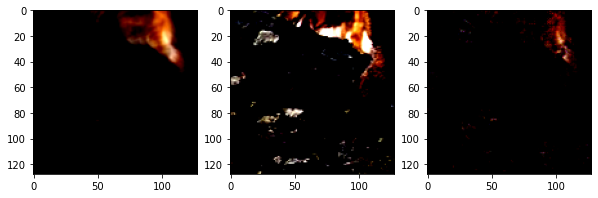

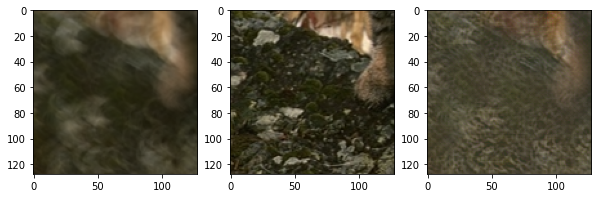

---- 0.0 ,, 1.0
=====
This is epoch 4
And the PSNR is 14.99942903272939
And the images are...


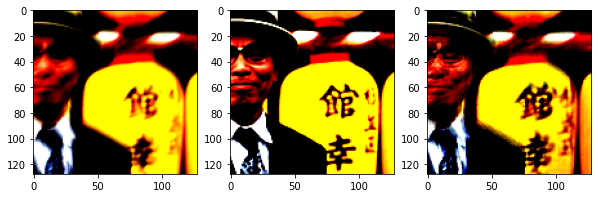

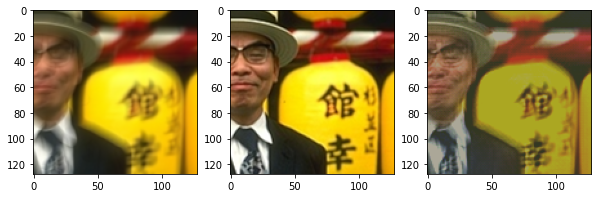

---- 0.15294114 ,, 1.0
=====
This is epoch 5
And the PSNR is 19.042954406172182
And the images are...


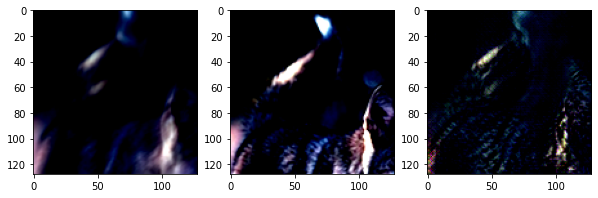

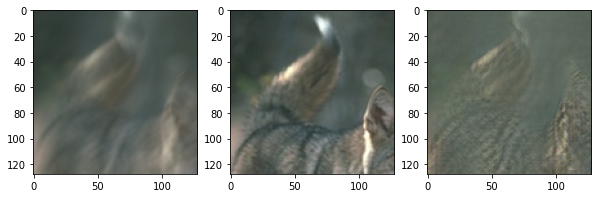

---- 0.098039195 ,, 1.0
=====
This is epoch 6
And the PSNR is 16.44173564705199
And the images are...


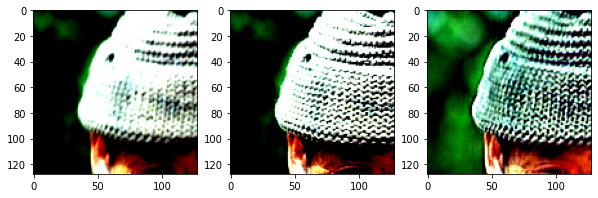

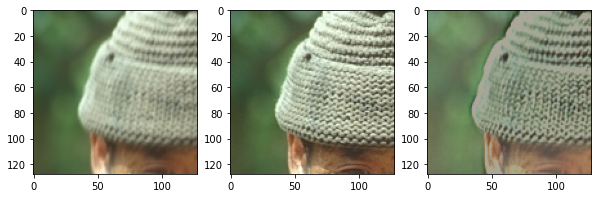

---- 0.023529379 ,, 0.7725489
=====
This is epoch 7
And the PSNR is 20.31270936811032
And the images are...


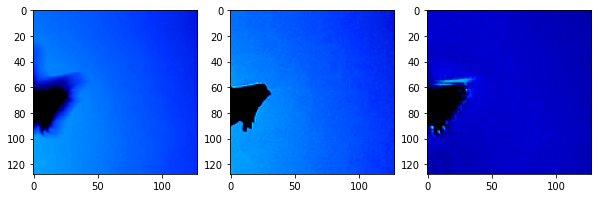

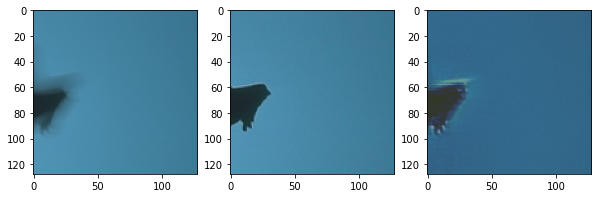

---- 0.0 ,, 1.0
=====
This is epoch 8
And the PSNR is 18.37356588379191
And the images are...


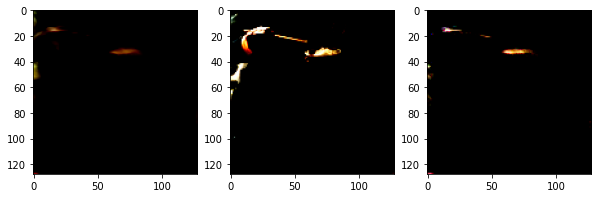

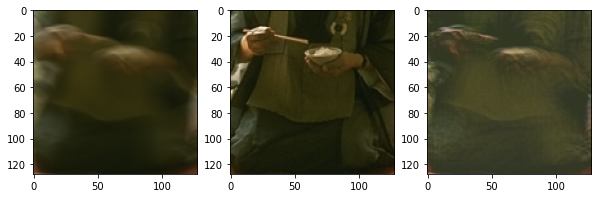

---- 0.0 ,, 1.0
=====
This is epoch 9
And the PSNR is 18.174855012662857
And the images are...


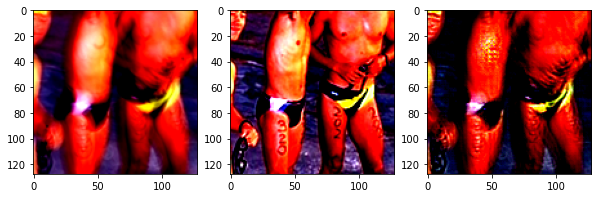

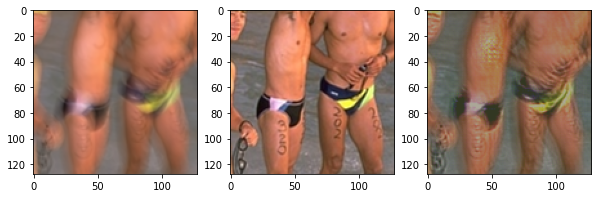

---- 0.14117645 ,, 1.0
=====
This is epoch 10
And the PSNR is 11.966032041343391
And the images are...


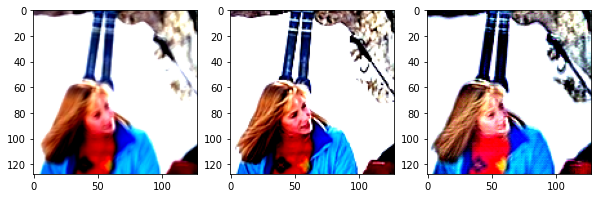

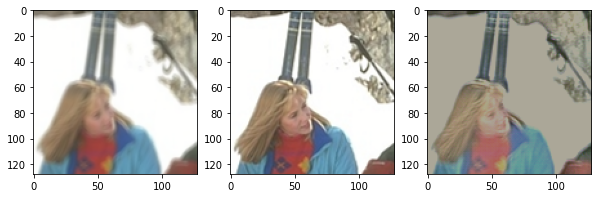

---- -2.811304e-08 ,, 0.8156862
=====
This is epoch 11
And the PSNR is 24.272331271490355
And the images are...


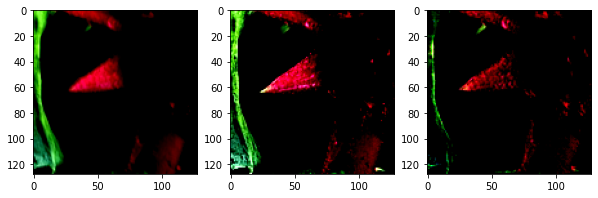

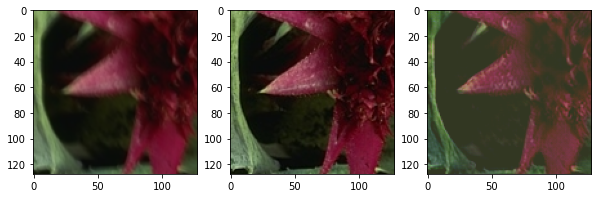

---- 0.039215665 ,, 1.0
=====
This is epoch 12
And the PSNR is 16.77122234734462
And the images are...


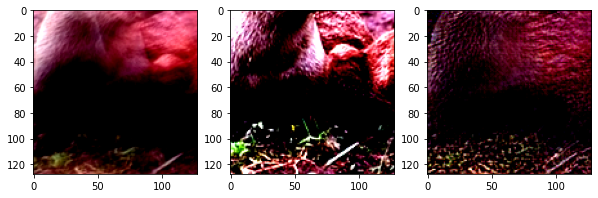

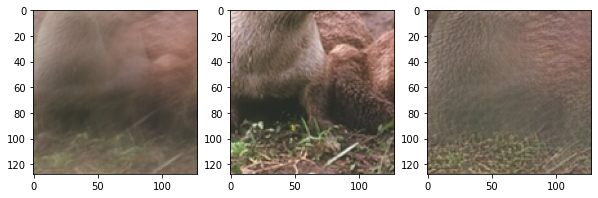

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 13
And the PSNR is 24.409413273069944
And the images are...


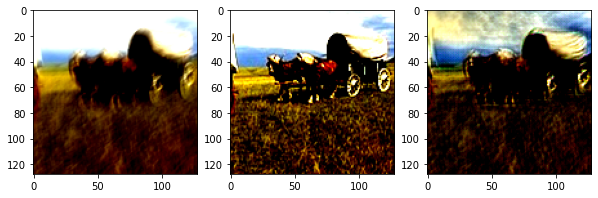

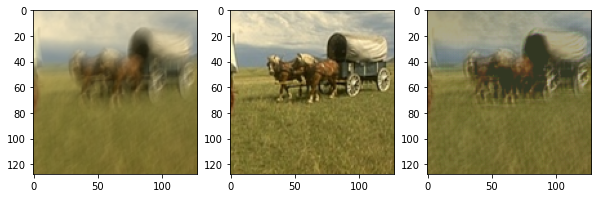

---- 0.0 ,, 0.86274505
=====
This is epoch 14
And the PSNR is 16.834965114959985
And the images are...


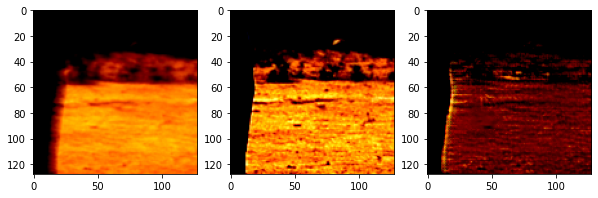

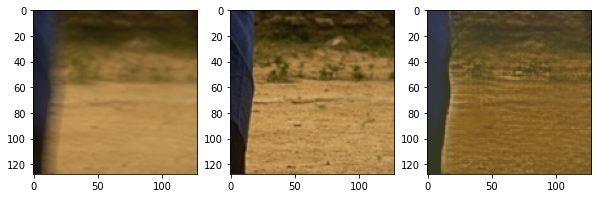

---- 0.0 ,, 0.98823524
=====
This is epoch 15
And the PSNR is 17.95084217284373
And the images are...


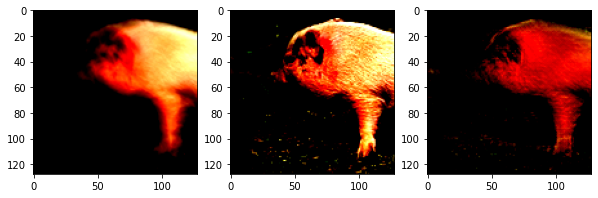

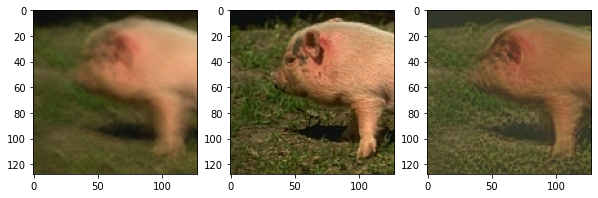

---- 0.0 ,, 0.9843136
=====
This is epoch 16
And the PSNR is 16.52001408993012
And the images are...


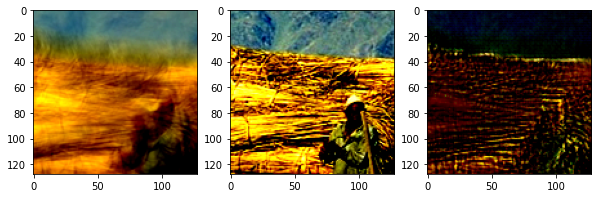

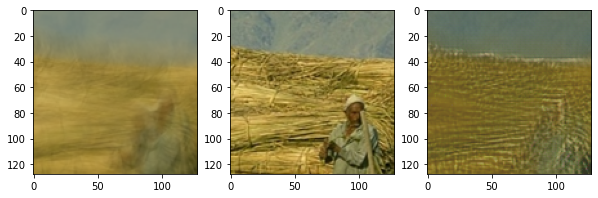

---- -2.811304e-08 ,, 1.0
=====
This is epoch 17
And the PSNR is 21.768291447687275
And the images are...


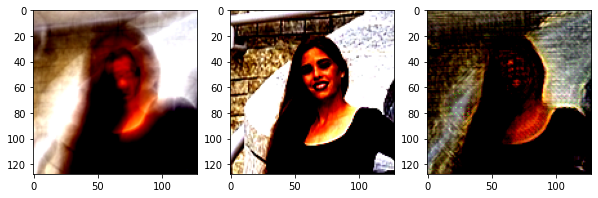

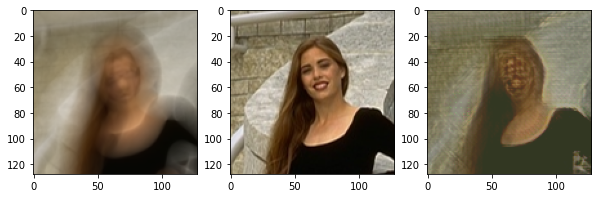

---- -2.811304e-08 ,, 1.0
=====
This is epoch 18
And the PSNR is 23.25140879057158
And the images are...


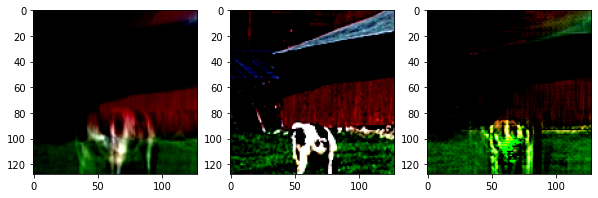

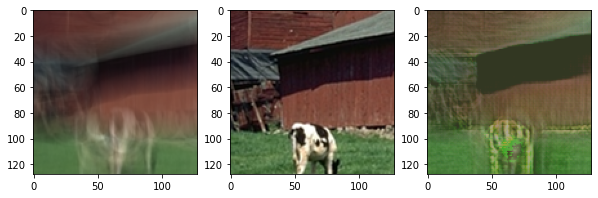

---- 0.0 ,, 1.0
=====
This is epoch 19
And the PSNR is 16.257910812487854
And the images are...


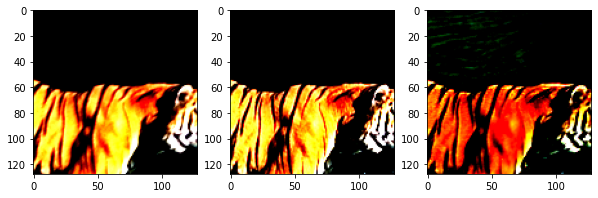

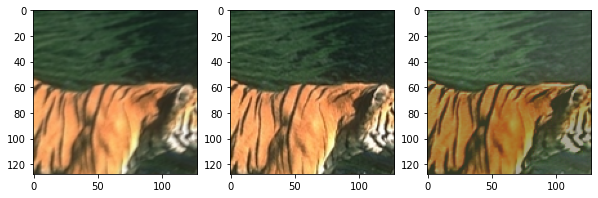

---- 0.0 ,, 0.55294114
=====
This is epoch 20
And the PSNR is 22.298983469124526
And the images are...


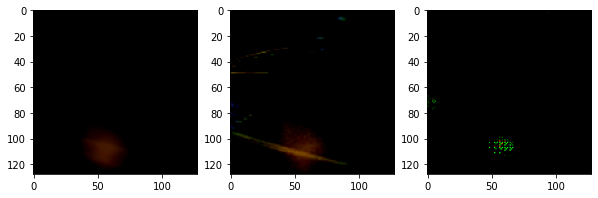

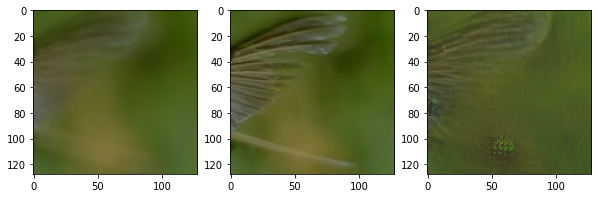

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 21
And the PSNR is 22.5862904877037
And the images are...


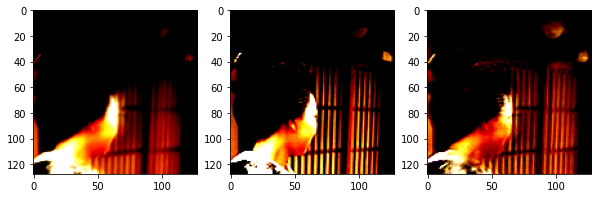

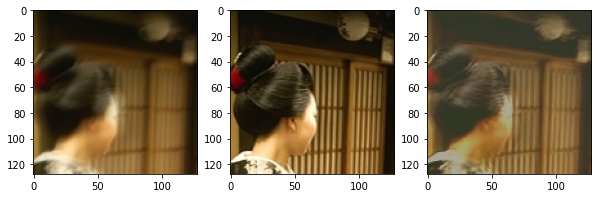

---- -2.811304e-08 ,, 1.0
=====
This is epoch 22
And the PSNR is 21.671493105750756
And the images are...


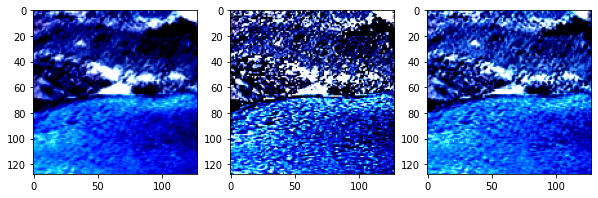

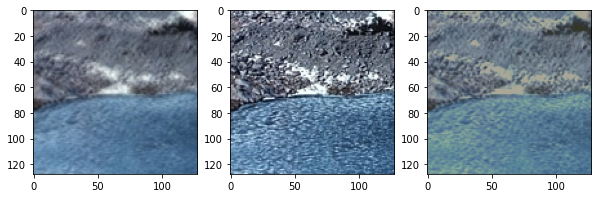

---- 0.0 ,, 1.0
=====
This is epoch 23
And the PSNR is 17.4103838658835
And the images are...


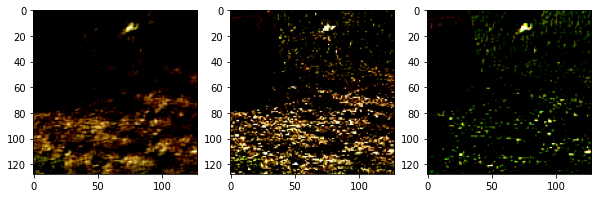

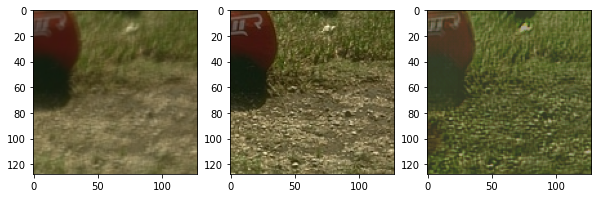

---- 0.0 ,, 1.0
=====
This is epoch 24
And the PSNR is 16.478217624936356
And the images are...


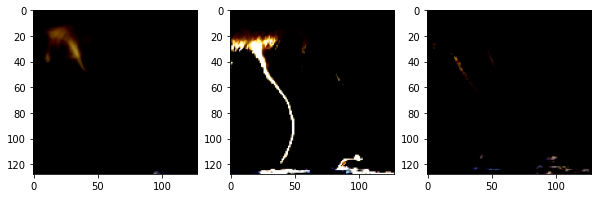

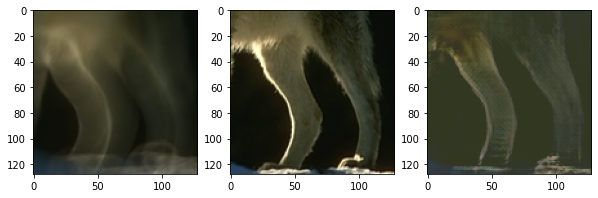

---- 0.12941176 ,, 0.8823529
=====
This is epoch 25
And the PSNR is 16.11148213849503
And the images are...


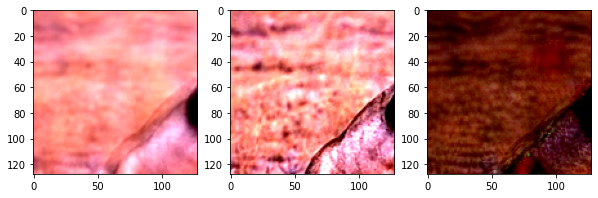

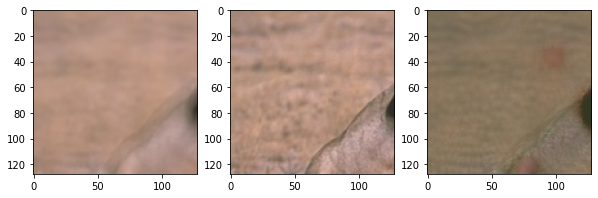

---- 0.07058821 ,, 0.94117635
=====
This is epoch 26
And the PSNR is 19.39172830576006
And the images are...


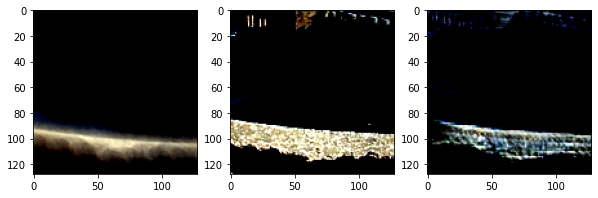

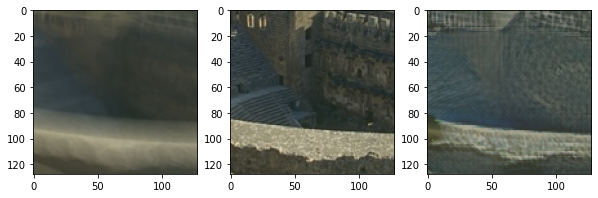

---- -2.811304e-08 ,, 1.0
=====
This is epoch 27
And the PSNR is 23.428636879471355
And the images are...


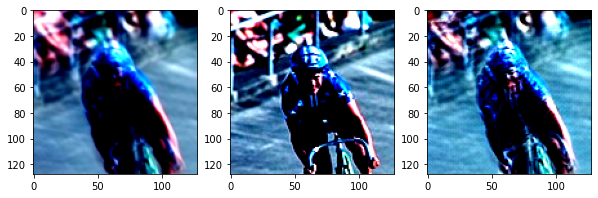

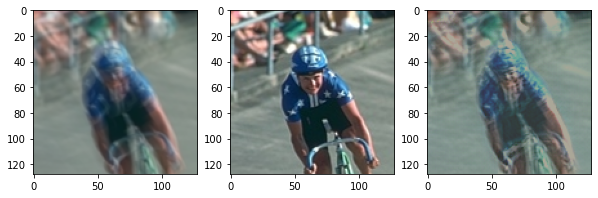

---- 0.02352941 ,, 1.0
=====
This is epoch 28
And the PSNR is 17.856568012571575
And the images are...


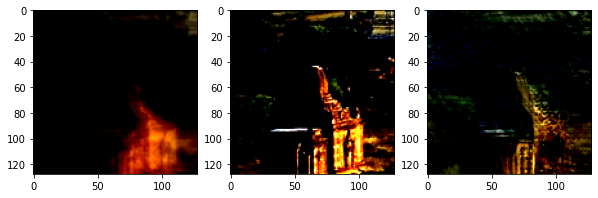

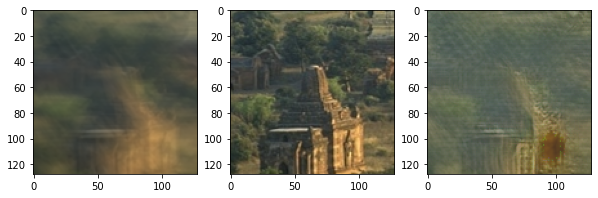

---- 0.05882353 ,, 1.0
=====
This is epoch 29
And the PSNR is 15.306968732233875
And the images are...


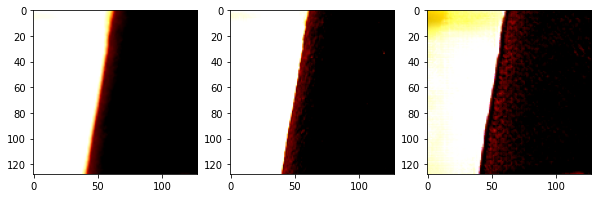

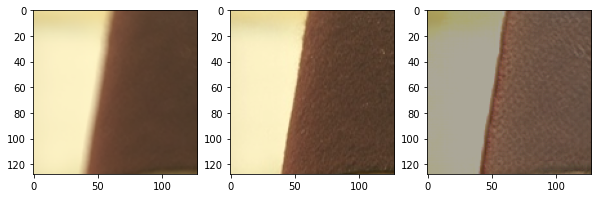

---- 0.05490193 ,, 1.0
=====
This is epoch 30
And the PSNR is 17.334276017882686
And the images are...


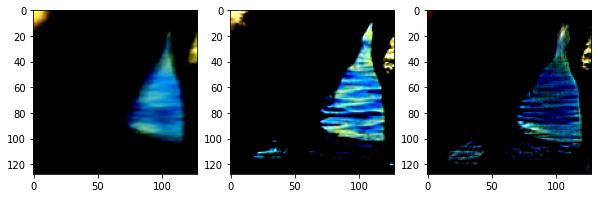

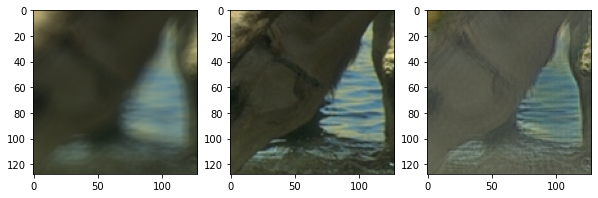

---- 0.0 ,, 1.0
=====
This is epoch 31
And the PSNR is 16.91386048615748
And the images are...


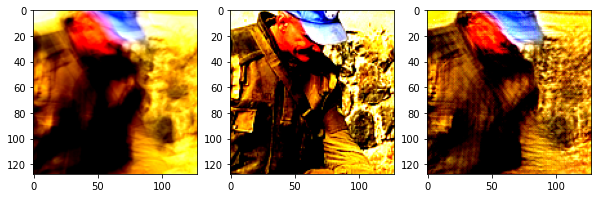

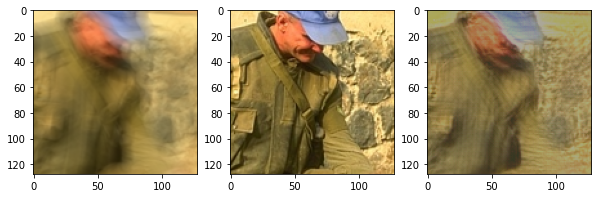

---- 0.0 ,, 1.0
=====
This is epoch 32
And the PSNR is 14.251022401753877
And the images are...


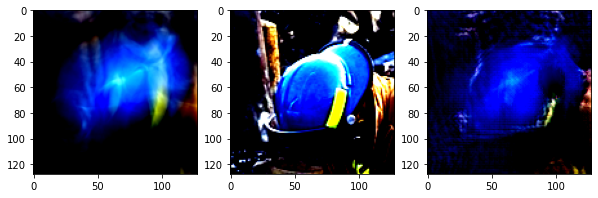

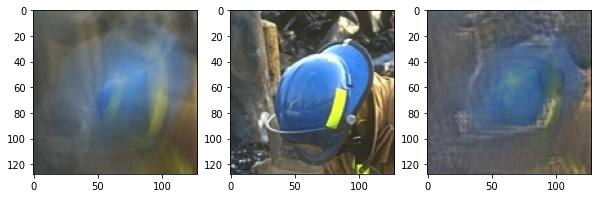

---- 0.0 ,, 1.0
=====
This is epoch 33
And the PSNR is 16.227742567888676
And the images are...


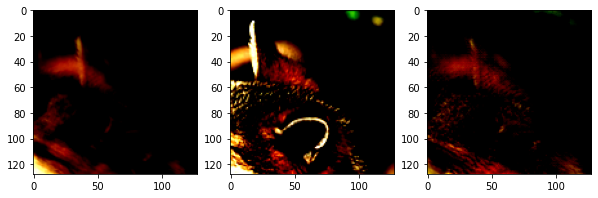

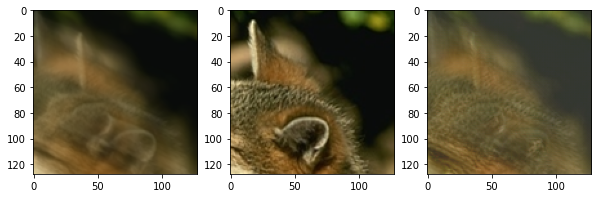

---- 0.003921544 ,, 1.0
=====
This is epoch 34
And the PSNR is 16.813195576949198
And the images are...


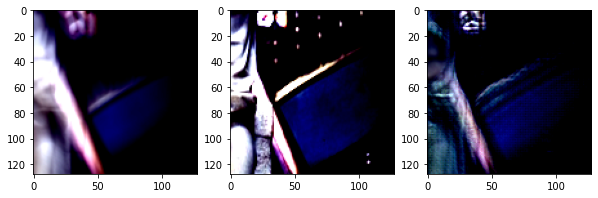

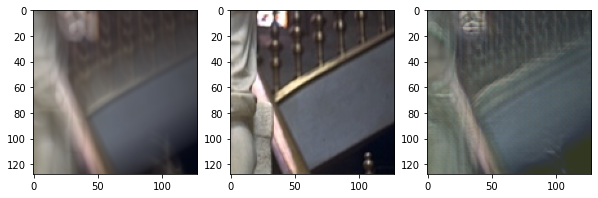

---- 0.07058821 ,, 1.0
=====
This is epoch 35
And the PSNR is 15.377551957311859
And the images are...


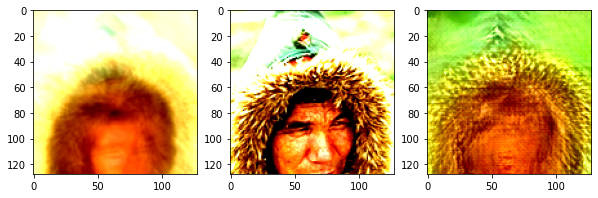

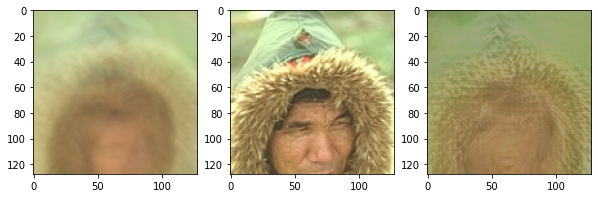

---- 0.10196077 ,, 1.0
=====
This is epoch 36
And the PSNR is 17.80444198350423
And the images are...


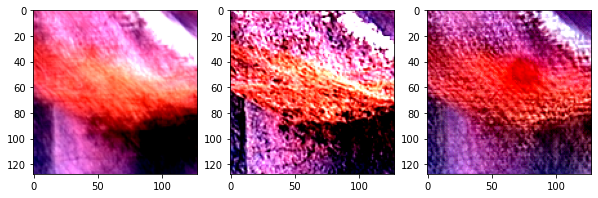

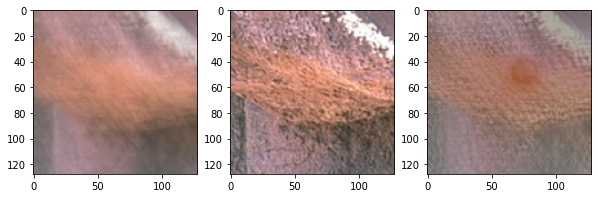

---- 0.0 ,, 1.0
=====
This is epoch 37
And the PSNR is 18.2452922829022
And the images are...


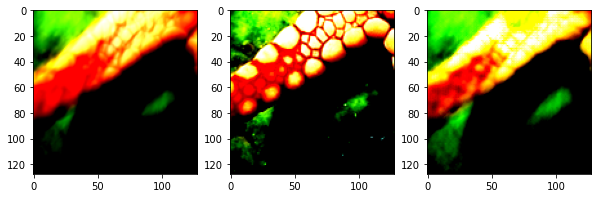

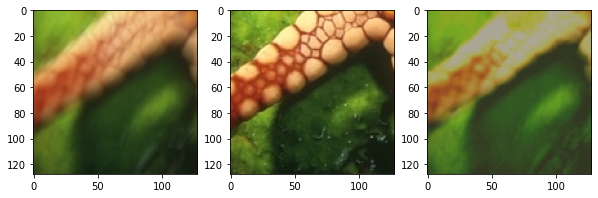

---- 0.0 ,, 1.0
=====
This is epoch 38
And the PSNR is 16.603861346512385
And the images are...


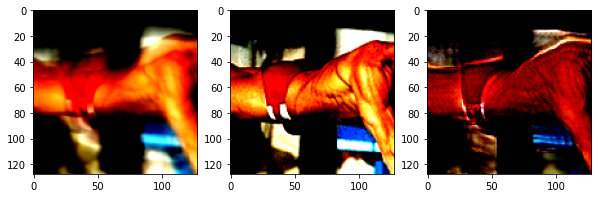

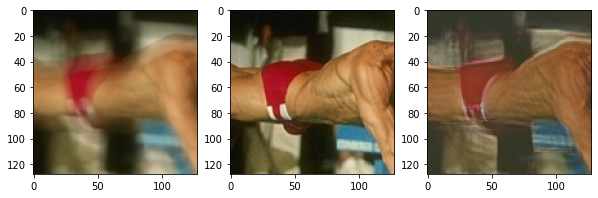

---- 0.031372525 ,, 1.0
=====
This is epoch 39
And the PSNR is 9.491863492867154
And the images are...


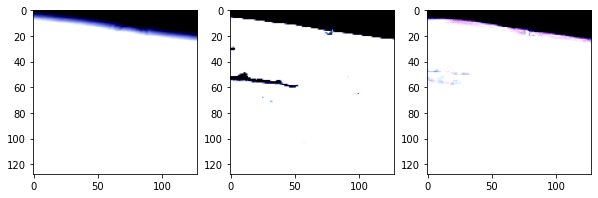

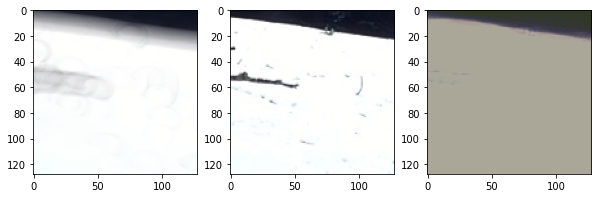

---- 0.0 ,, 1.0
=====
This is epoch 40
And the PSNR is 17.645573078118453
And the images are...


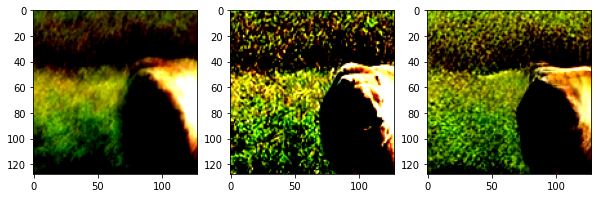

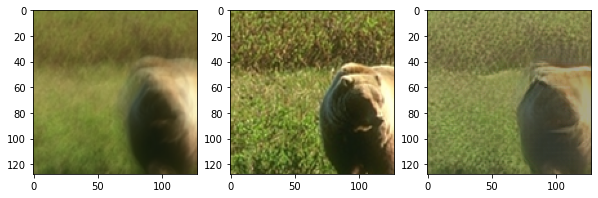

---- 0.05882353 ,, 1.0
=====
This is epoch 41
And the PSNR is 18.762718979782495
And the images are...


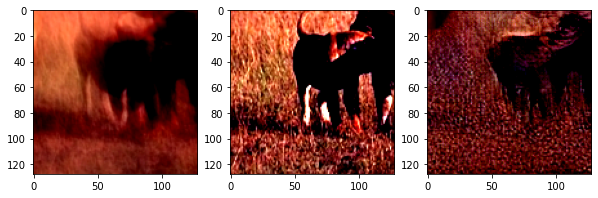

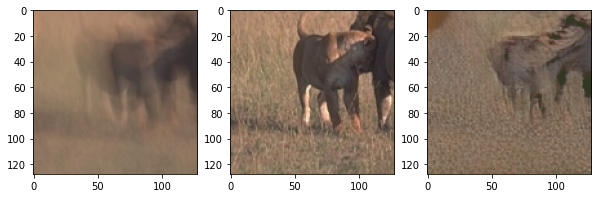

---- 0.0 ,, 1.0
=====
This is epoch 42
And the PSNR is 14.082416223445101
And the images are...


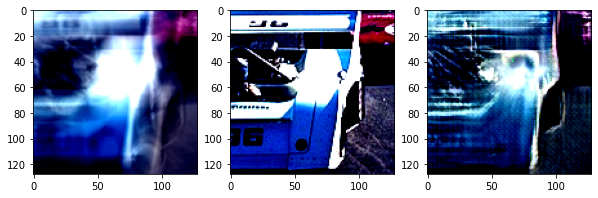

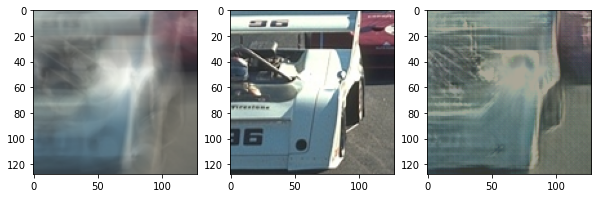

---- 0.0 ,, 1.0
=====
This is epoch 43
And the PSNR is 16.23560235581766
And the images are...


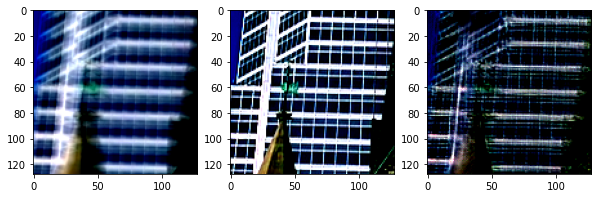

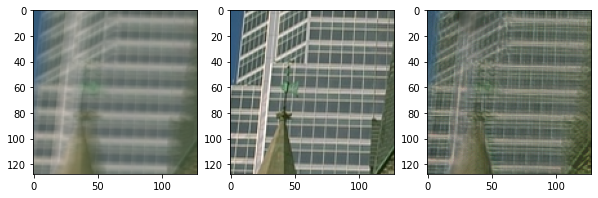

---- 0.0 ,, 1.0
=====
This is epoch 44
And the PSNR is 16.415263487077265
And the images are...


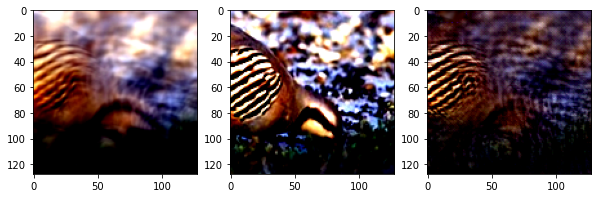

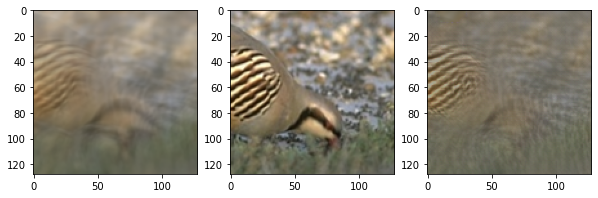

---- 0.03137254 ,, 1.0
=====
This is epoch 45
And the PSNR is 14.247913697413175
And the images are...


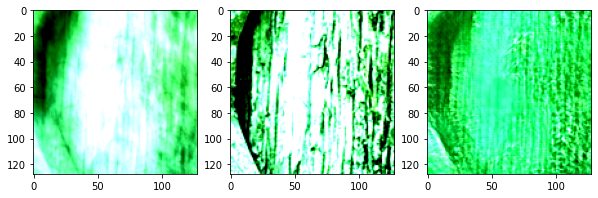

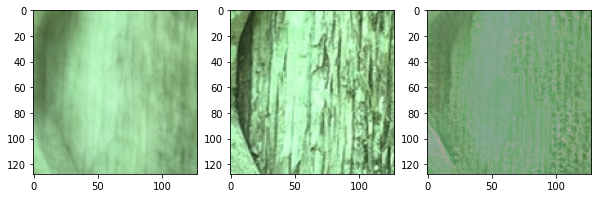

---- 0.2862745 ,, 0.5960784
=====
This is epoch 46
And the PSNR is 25.7747086968998
And the images are...


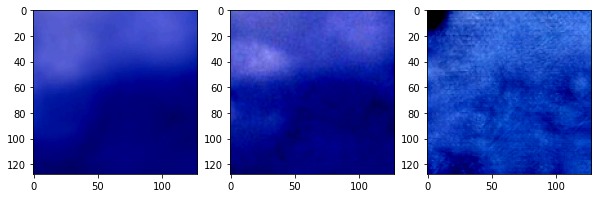

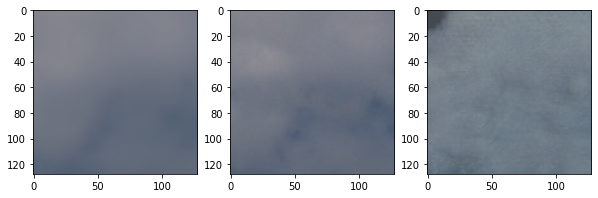

---- -2.6311284e-08 ,, 1.0
=====
This is epoch 47
And the PSNR is 22.175325698744146
And the images are...


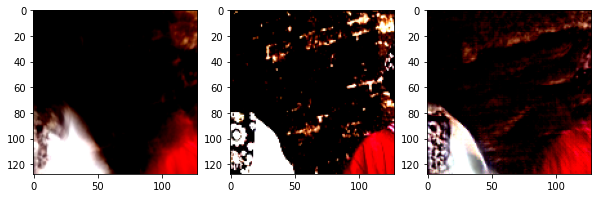

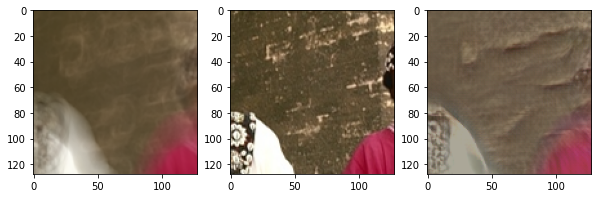

---- 0.0 ,, 1.0
=====
This is epoch 48
And the PSNR is 20.58090571800365
And the images are...


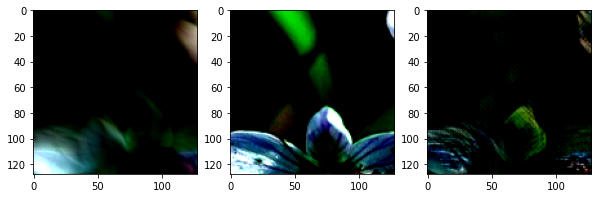

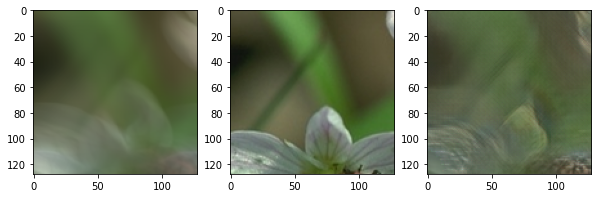

---- 0.0 ,, 1.0
=====
This is epoch 49
And the PSNR is 18.095533141322225
And the images are...


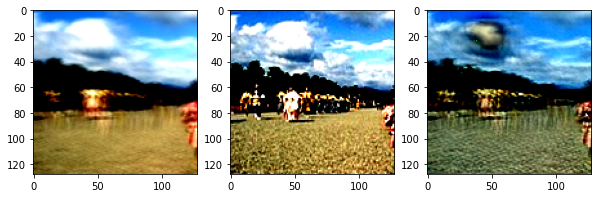

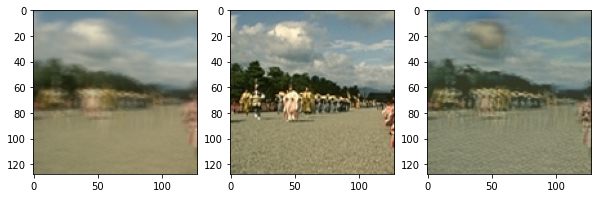

---- 0.1098039 ,, 1.0
=====
This is epoch 50
And the PSNR is 13.191071480650846
And the images are...


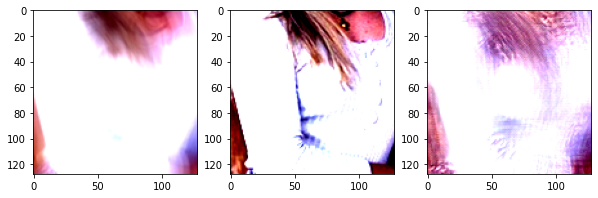

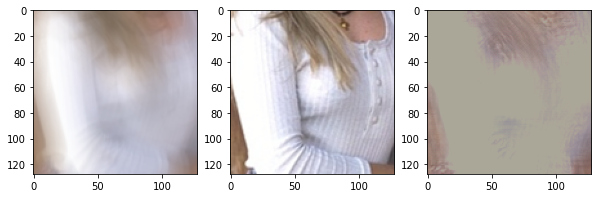

In [ ]:
datamodule = BSD_B_DataModule(path, batch_size=batch_size, target_size=target_size, mean=mean, std=std)

deblurgan = DeblurGAN(3, 3, learning_rate=lr, lambda_content=lambda_content, display_step=display_step, mean=mean, std=std)
trainer = pl.Trainer(max_epochs=n_epochs, gpus=1, callbacks=[checkpoint_callback])   # REMEMBER THE GPU
trainer.fit(deblurgan, datamodule)